# Semantic Segmentation of Aerial Images
by Salaheldin Bilila

## Kaggle and dataset setup

In [ ]:
#%tensorflow_version 1.x
import tensorflow as tf
print(tf.__version__)

2.8.2


In [ ]:
#install kaggle
!pip install -q kaggle
#!pip install 'h5py==2.10.0' -q --force-reinstall

     |████████████████████████████████| 3.3 MB 7.5 MB/s 
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.


In [ ]:
#install the kaggle token
import os
import json

kaggle_token = 'kaggle.json'
with open(kaggle_token, "w") as f:
            json.dump({
                "username": "salaheldinbilila",
                "key": "fb4ac125d79bb7f46ee78c67c47566c4"
            }, f)

In [ ]:
#Create the .kaggle directory with the .json file inside it
!rm -r ~/.kaggle
!mkdir ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json
!kaggle datasets list

rm: cannot remove '/root/.kaggle': No such file or directory
ref                                                                title                                                size  lastUpdated          downloadCount  voteCount  usabilityRating  
-----------------------------------------------------------------  --------------------------------------------------  -----  -------------------  -------------  ---------  ---------------  
victorsoeiro/netflix-tv-shows-and-movies                           Netflix TV Shows and Movies                           2MB  2022-05-15 00:01:23          13655        398  1.0              
zusmani/petrolgas-prices-worldwide                                 Petrol/Gas Prices Worldwide                          10KB  2022-06-24 01:25:33           1454         78  1.0              
ruchi798/data-science-job-salaries                                 Data Science Job Salaries                             7KB  2022-06-15 08:59:12           2462         83  1.

In [ ]:
# Download the dataset
!kaggle datasets download -d bulentsiyah/semantic-drone-dataset

100% 3.89G/3.89G [00:38<00:00, 209MB/s]
100% 3.89G/3.89G [00:38<00:00, 108MB/s]


In [ ]:
# Unzip the dataset
%%capture
!unzip semantic-drone-dataset.zip

In [ ]:
!mv dataset/semantic_drone_dataset/original_images/ .
!mv dataset/semantic_drone_dataset/label_images_semantic/ .
!rm -r dataset semantic-drone-dataset.zip
!mkdir train_images train_masks val_images val_masks test_images test_masks checkpoints

In [ ]:
# The paths for the dataset
import os
IMAGE_PATH = "original_images/"
MASK_PATH = "label_images_semantic/"

In [ ]:
# Get the dataset file names using pandas
import pandas as pd
import numpy as np
def create_df(path):
    name = []
    for dirname, _, filenames in os.walk(path):
        for filename in filenames:
            name.append(filename.split('.')[0])

    return pd.DataFrame({'id': name}, index = np.arange(0, len(name)))

In [ ]:
df = create_df('original_images/')
print('Total Images: ', len(df))

Total Images:  400


In [ ]:
# Split the files into train,val,test
import random
data = list(df['id'].values)
total_len = len(data)
random.seed(24)
train_data = random.sample(data, int(0.7 * total_len))
remaining_data = list(set(data) - set(train_data))
validation_data = random.sample(remaining_data, int(0.15 * total_len))
test_data = list(set(remaining_data) - set(validation_data))
print('Train Size.     : ', len(train_data))
print('Validation Size : ', len(validation_data))
print('Test Size.      : ', len(test_data))

Train Size.     :  280
Validation Size :  60
Test Size.      :  60


In [ ]:
# Get the files and split to train,val,test folders
def split_dataset_files(data,img_path,mask_path,split):
  for i in range(len(data)):
    os.system('mv '+img_path+data[i]+'.jpg '+split+'_images/')
    os.system('mv '+mask_path+data[i]+'.png '+split+'_masks/')

split_dataset_files(train_data,IMAGE_PATH,MASK_PATH,'train')
split_dataset_files(validation_data,IMAGE_PATH,MASK_PATH,'val')
split_dataset_files(test_data,IMAGE_PATH,MASK_PATH,'test')

In [ ]:
!rm -r original_images/ label_images_semantic/

## Data preprocessing and Libraries

In [ ]:
#%tensorflow_version 1.x

In [ ]:
#!pip install -q keras-segmentation
!git clone https://github.com/divamgupta/image-segmentation-keras
!cp -r image-segmentation-keras/keras_segmentation/ keras_segmentation/

In [ ]:
import pandas as pd
import numpy as np
import os
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
%matplotlib inline
from keras_segmentation.models.unet import resnet50_unet
import cv2 as cv
from google.colab.patches import cv2_imshow

In [ ]:
BASE_PATH = 'drive/MyDrive/Semantic_Drone/dataset/'
TRAIN_IMAGES = BASE_PATH + 'train_images/'
TRAIN_MASKS = BASE_PATH + 'train_masks/'
VAL_IMAGES = BASE_PATH + 'val_images/'
VAL_MASKS = BASE_PATH + 'val_masks/'
TEST_IMAGES = BASE_PATH + 'test_images/'
TEST_MASKS = BASE_PATH + 'test_masks/'
CHECKPOINT_PATH = BASE_PATH + 'checkpoints/checkpoint'
#CHECKPOINT_PATH = 'checkpoint'

In [ ]:
color_map = pd.read_csv(BASE_PATH + 'class_dict_seg.csv').to_dict()
color_map['name']
classes = {v: k for k, v in color_map['name'].items()}
classes

{'unlabeled': 0,
 'paved-area': 1,
 'dirt': 2,
 'grass': 3,
 'gravel': 4,
 'water': 5,
 'rocks': 6,
 'pool': 7,
 'vegetation': 8,
 'roof': 9,
 'wall': 10,
 'window': 11,
 'door': 12,
 'fence': 13,
 'fence-pole': 14,
 'person': 15,
 'dog': 16,
 'car': 17,
 'bicycle': 18,
 'tree': 19,
 'bald-tree': 20,
 'ar-marker': 21,
 'obstacle': 22,
 'conflicting': 23}

In [ ]:
# Prepare color_map
#color_map = pd.read_csv('/content/class_dict_seg.csv').to_dict('index')
color_map = pd.read_csv(BASE_PATH + 'class_dict_seg.csv').to_dict('index')
del color_map[23]
for key in color_map:
  color_map[key]['rgb']=[color_map[key][' r'],color_map[key][' g'],color_map[key][' b']]
  del color_map[key][' r']
  del color_map[key][' g']
  del color_map[key][' b']
color_map

{0: {'name': 'unlabeled', 'rgb': [0, 0, 0]},
 1: {'name': 'paved-area', 'rgb': [128, 64, 128]},
 2: {'name': 'dirt', 'rgb': [130, 76, 0]},
 3: {'name': 'grass', 'rgb': [0, 102, 0]},
 4: {'name': 'gravel', 'rgb': [112, 103, 87]},
 5: {'name': 'water', 'rgb': [28, 42, 168]},
 6: {'name': 'rocks', 'rgb': [48, 41, 30]},
 7: {'name': 'pool', 'rgb': [0, 50, 89]},
 8: {'name': 'vegetation', 'rgb': [107, 142, 35]},
 9: {'name': 'roof', 'rgb': [70, 70, 70]},
 10: {'name': 'wall', 'rgb': [102, 102, 156]},
 11: {'name': 'window', 'rgb': [254, 228, 12]},
 12: {'name': 'door', 'rgb': [254, 148, 12]},
 13: {'name': 'fence', 'rgb': [190, 153, 153]},
 14: {'name': 'fence-pole', 'rgb': [153, 153, 153]},
 15: {'name': 'person', 'rgb': [255, 22, 96]},
 16: {'name': 'dog', 'rgb': [102, 51, 0]},
 17: {'name': 'car', 'rgb': [9, 143, 150]},
 18: {'name': 'bicycle', 'rgb': [119, 11, 32]},
 19: {'name': 'tree', 'rgb': [51, 51, 0]},
 20: {'name': 'bald-tree', 'rgb': [190, 250, 190]},
 21: {'name': 'ar-marker', 

In [ ]:
# List of color tuples of the classes & class names
class_colors = [tuple(color_map[key]['rgb']) for key in color_map]
class_names = [color_map[key]['name'] for key in color_map]

In [ ]:
# Get the colored mask from the segmented mask
def mask_to_color(mask,map_dict):
  rgb_mask = np.zeros(mask.shape + (3,),dtype=np.uint8)
  for key in np.unique(mask):
    rgb_mask[mask==key] = map_dict[key]['rgb']
  return rgb_mask

In [ ]:
# Get the legend handles required for plotting
def create_legend_handles(mask,map_dict):
  handles = []
  for key in np.unique(mask):
    color_val = [x/255.0 for x in map_dict[key]['rgb']]
    name = map_dict[key]['name']
    h = mpatches.Patch(color=tuple(color_val), label=name)
    handles.append(h)
  return handles

In [ ]:
model = resnet50_unet(n_classes=23 ,  input_height=416, input_width=608)
#model = resnet50_unet(n_classes=23 ,  input_height=704, input_width=1056)

94666752/94653016 [==============================] - 3s 0us/step


In [ ]:
!cp -r drive/MyDrive/Semantic_Drone/dataset/checkpoints/ .

## Training

In [ ]:
model.train(
    train_images = TRAIN_IMAGES,
    train_annotations = TRAIN_MASKS,
    checkpoints_path = CHECKPOINT_PATH,
    verify_dataset=False,
    validate = True,
    val_images = VAL_IMAGES,
    val_annotations = VAL_MASKS,
    auto_resume_checkpoint=True,
    batch_size=2,
    #do_augment=True,
    steps_per_epoch=None,
    val_steps_per_epoch=None,
    gen_use_multiprocessing=True,
    epochs=15
)

Epoch 1/15


In [ ]:
!cp -r checkpoints/ drive/MyDrive/Semantic_Drone/dataset/checkpoints/

## Testing

In [ ]:
from keras_segmentation.train import find_latest_checkpoint
latest_checkpoint = find_latest_checkpoint(CHECKPOINT_PATH)
print(latest_checkpoint)
model.load_weights(latest_checkpoint)

drive/MyDrive/Semantic_Drone/dataset/checkpoints/checkpoint.14


In [ ]:
metrics = model.evaluate_segmentation(
    inp_images_dir=TEST_IMAGES,
    annotations_dir=TEST_MASKS,
    checkpoints_path=CHECKPOINT_PATH
)
print(metrics)

7it [01:03,  9.10s/it]


KeyboardInterrupt: ignored

In [ ]:
from keras_segmentation.predict import predict
out_label = model.predict_segmentation(
#_ = predict(
    inp=TRAIN_IMAGES+'000.jpg',
    #overlay_img = True,
    #colors = class_colors,
    checkpoints_path=CHECKPOINT_PATH
)

100%|██████████| 3/3 [00:23<00:00,  7.67s/it]


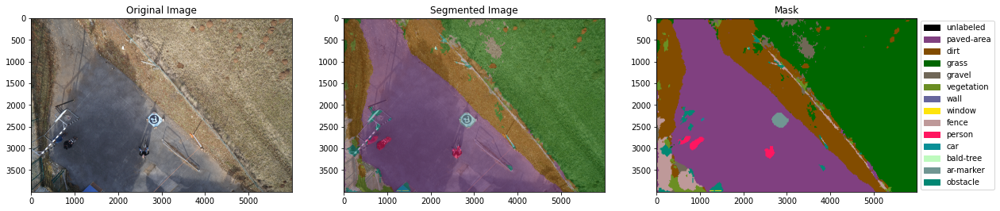

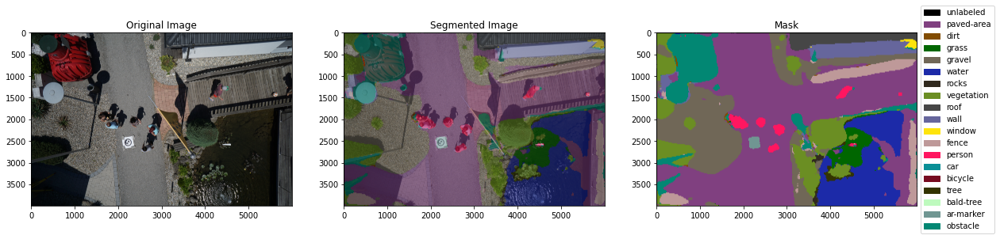

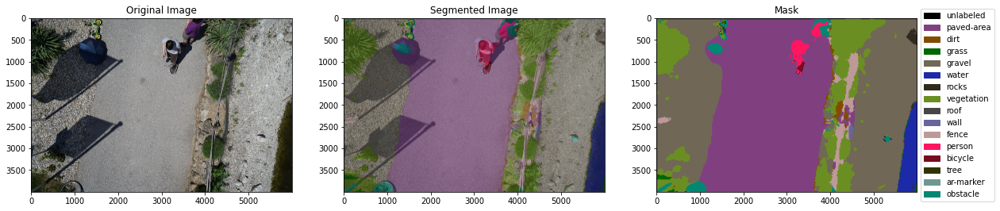

In [ ]:
import glob
from tqdm import tqdm
from keras_segmentation.data_utils.data_loader import get_image_array
import random

output_width = model.output_width
output_height = model.output_height
input_width = model.input_width
input_height = model.input_height
n_classes = model.n_classes
inps = glob.glob(os.path.join(TEST_IMAGES, "*.jpg")) + glob.glob(
    os.path.join(TEST_IMAGES, "*.png")) + \
    glob.glob(os.path.join(TEST_IMAGES, "*.jpeg"))
inps = sorted(inps)
for inp in tqdm(random.sample(inps,3)):
  inp = cv.imread(inp, 1)
  x = get_image_array(inp, input_width, input_height,ordering=None)
  pr = model.predict(np.array([x]))[0]
  pr = pr.reshape((output_height,  output_width, n_classes)).argmax(axis=2)
  pr = cv.resize(pr, (inp.shape[1], inp.shape[0]), interpolation=cv.INTER_NEAREST)
  h=create_legend_handles(pr,color_map)
  pr = mask_to_color(pr,color_map)
  inp = cv.cvtColor(inp,cv.COLOR_BGR2RGB)
  fig ,arr  = plt.subplots(1,3,figsize=(20,15))
  arr[0].imshow(inp)
  arr[0].set_title('Original Image')
  arr[1].imshow(inp)
  arr[1].imshow(pr,alpha=0.5)
  arr[1].set_title('Segmented Image')
  arr[2].imshow(pr)
  arr[2].set_title('Mask')
  arr[2].legend(handles=h,bbox_to_anchor=(1, 0.5), loc='center left')

In [ ]:
x = cv.imread(inps[0], 1)
x = get_image_array(x, input_width, input_height,ordering=None)
x.dtype
#plt.imshow(x)

dtype('float32')

## Holyrood Dataset Training


In [ ]:
!cp -r /content/drive/MyDrive/Semantic_Drone/Holyrood_Dataset/ Holyrood_Dataset/

In [ ]:
BASE_PATH = '/content/drive/MyDrive/Semantic_Drone/Holyrood_Dataset/'
TRAIN_IMAGES = BASE_PATH + 'images/'
TRAIN_MASKS = BASE_PATH + 'masks/'
TEST_IMAGES = BASE_PATH + 'test/'
CHECKPOINT_PATH = BASE_PATH + 'checkpoints/checkpoint'

In [ ]:
model.train(
    train_images = TRAIN_IMAGES,
    train_annotations = TRAIN_MASKS,
    checkpoints_path = CHECKPOINT_PATH,
    batch_size=2,
    verify_dataset=True,
    auto_resume_checkpoint=True,
    steps_per_epoch=None,
    epochs=15
)

Verifying training dataset


100%|██████████| 22/22 [00:10<00:00,  2.18it/s]


Dataset verified! 

Epoch 1/15
11/11 [==============================] - 20s 2s/step - loss: 4.3284 - accuracy: 0.3656
saved  /content/drive/MyDrive/Semantic_Drone/Holyrood_Dataset/checkpoints/checkpoint.0
Epoch 2/15
11/11 [==============================] - 3s 272ms/step - loss: 1.8911 - accuracy: 0.6997
saved  /content/drive/MyDrive/Semantic_Drone/Holyrood_Dataset/checkpoints/checkpoint.1
Epoch 3/15
11/11 [==============================] - 9s 809ms/step - loss: 1.4396 - accuracy: 0.7489
saved  /content/drive/MyDrive/Semantic_Drone/Holyrood_Dataset/checkpoints/checkpoint.2
Epoch 4/15
11/11 [==============================] - 11s 974ms/step - loss: 1.1682 - accuracy: 0.7765
saved  /content/drive/MyDrive/Semantic_Drone/Holyrood_Dataset/checkpoints/checkpoint.3
Epoch 5/15
11/11 [==============================] - 12s 1s/step - loss: 0.8739 - accuracy: 0.8491
saved  /content/drive/MyDrive/Semantic_Drone/Holyrood_Dataset/checkpoints/checkpoint.4
Epoch 6/15
11/11 [==============================

In [ ]:
checkpoint = CHECKPOINT_PATH+'.14'
print(checkpoint)
model.load_weights(checkpoint)

/content/drive/MyDrive/Semantic_Drone/Holyrood_Dataset/checkpoints/checkpoint.14


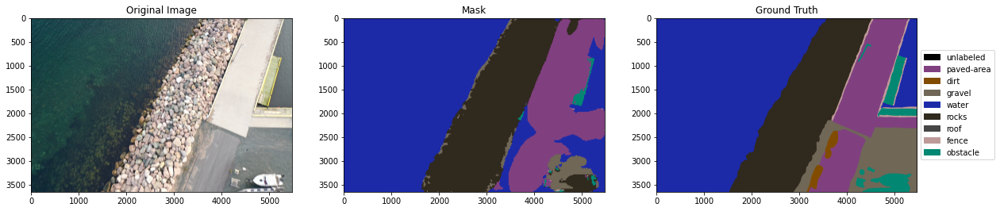

In [ ]:
inp = TRAIN_IMAGES + 'DJI_0188.jpg'
inp = cv.imread(inp, 1)
gt = TRAIN_MASKS + 'DJI_0188.png'
gt = cv.imread(gt,0)
gt = mask_to_color(gt,color_map)
x = get_image_array(inp, input_width, input_height,ordering=None)
pr = model.predict(np.array([x]))[0]
pr = pr.reshape((output_height,  output_width, n_classes)).argmax(axis=2)
pr = cv.resize(pr, (inp.shape[1], inp.shape[0]), interpolation=cv.INTER_NEAREST)
h=create_legend_handles(pr,color_map)
pr = mask_to_color(pr,color_map)
inp = cv.cvtColor(inp,cv.COLOR_BGR2RGB)
fig ,arr  = plt.subplots(1,3,figsize=(20,15))
arr[0].imshow(inp)
arr[0].set_title('Original Image')
arr[2].imshow(gt)
arr[2].set_title('Ground Truth')
arr[1].imshow(pr)
arr[1].set_title('Mask')
arr[2].legend(handles=h,bbox_to_anchor=(1, 0.5), loc='center left')

  0%|          | 0/7 [00:00<?, ?it/s]

100%|██████████| 7/7 [00:40<00:00,  5.74s/it]


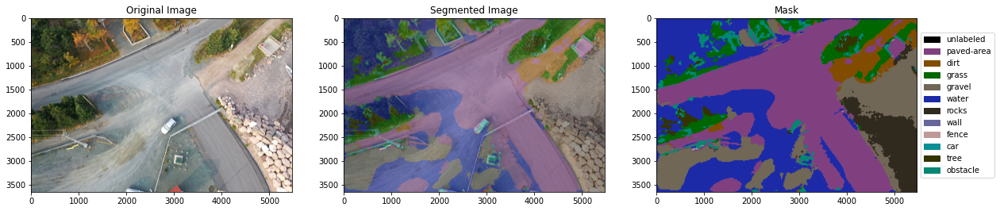

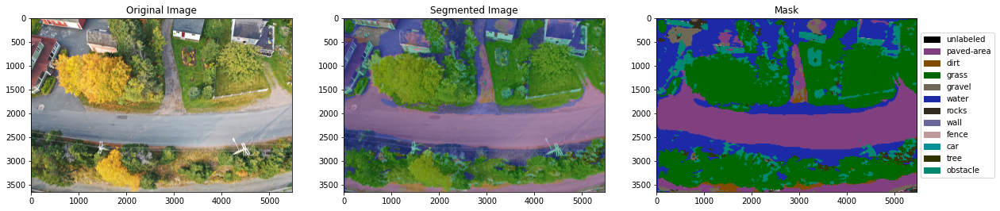

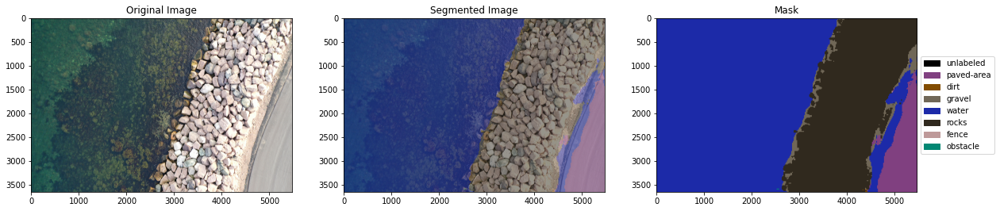

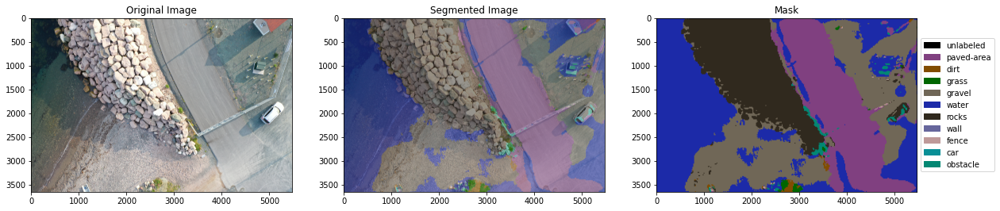

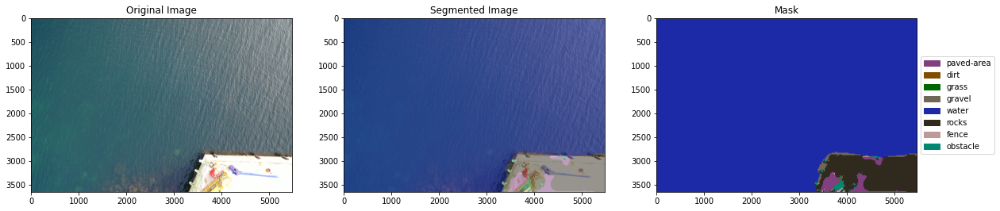

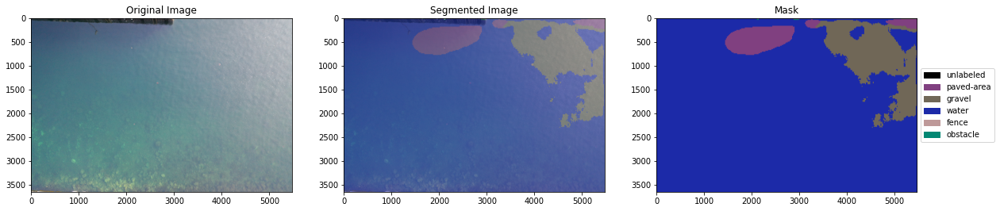

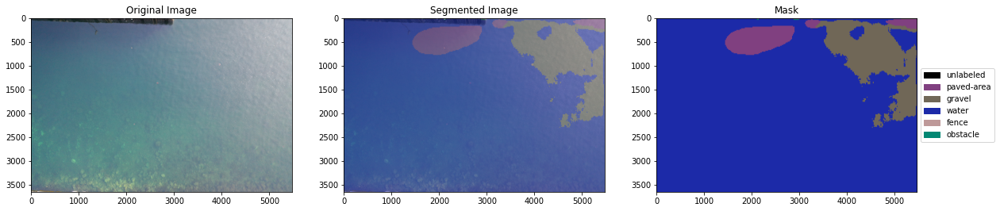

In [ ]:
import glob
from tqdm import tqdm
from keras_segmentation.data_utils.data_loader import get_image_array

output_width = model.output_width
output_height = model.output_height
input_width = model.input_width
input_height = model.input_height
n_classes = model.n_classes
inps = glob.glob(os.path.join(TEST_IMAGES, "*.jpg")) + \
    glob.glob(os.path.join(TEST_IMAGES, "*.JPG"))
inps = sorted(inps)
for inp in tqdm(inps):
  inp = cv.imread(inp, 1)
  x = get_image_array(inp, input_width, input_height,ordering=None)
  pr = model.predict(np.array([x]))[0]
  pr = pr.reshape((output_height,  output_width, n_classes)).argmax(axis=2)
  pr = cv.resize(pr, (inp.shape[1], inp.shape[0]), interpolation=cv.INTER_NEAREST)
  h=create_legend_handles(pr,color_map)
  pr = mask_to_color(pr,color_map)
  inp = cv.cvtColor(inp,cv.COLOR_BGR2RGB)
  fig ,arr  = plt.subplots(1,3,figsize=(20,15))
  arr[0].imshow(inp)
  arr[0].set_title('Original Image')
  arr[1].imshow(inp)
  arr[1].imshow(pr,alpha=0.5)
  arr[1].set_title('Segmented Image')
  arr[2].imshow(pr)
  arr[2].set_title('Mask')
  arr[2].legend(handles=h,bbox_to_anchor=(1, 0.5), loc='center left')

## Bell 412 dataset

In [ ]:
BASE_PATH = '/content/drive/MyDrive/dataset_toSalah/'
TEST_IMAGES = BASE_PATH + 'pics/'

100%|██████████| 36/36 [00:42<00:00,  1.19s/it]


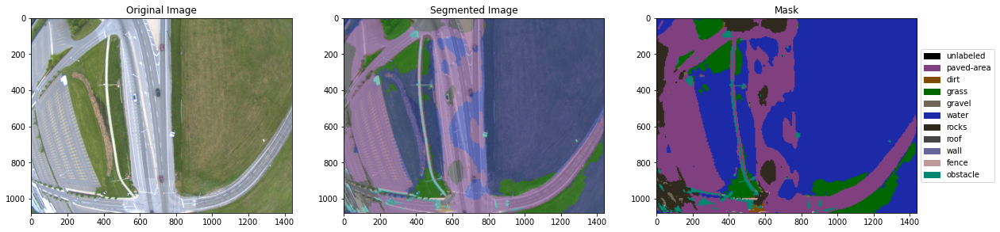

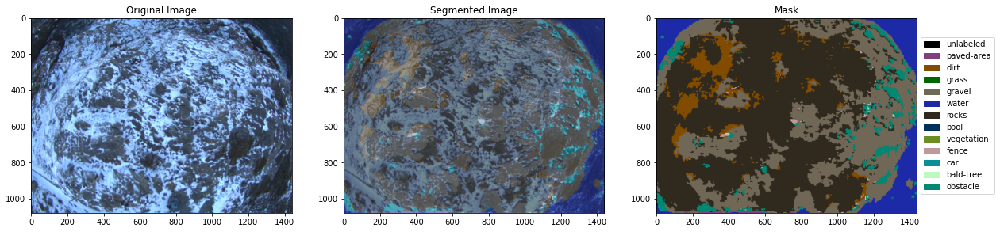

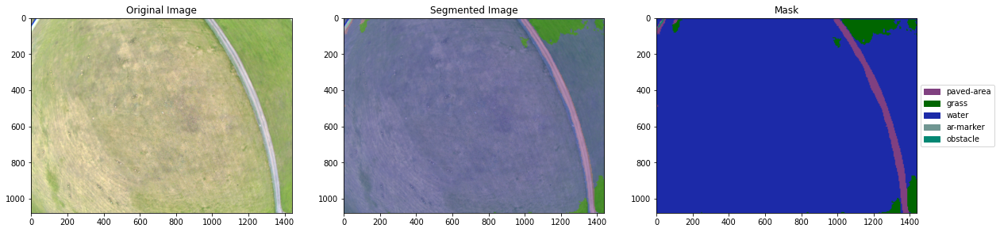

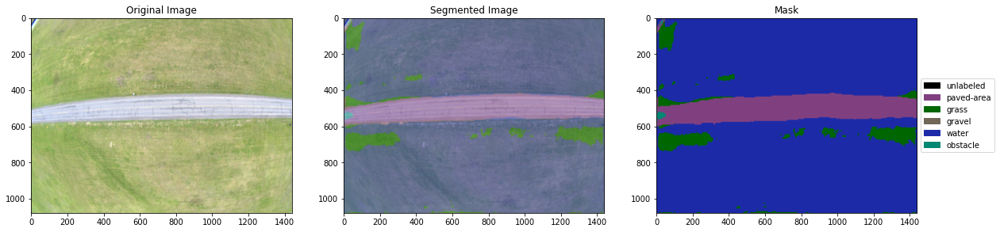

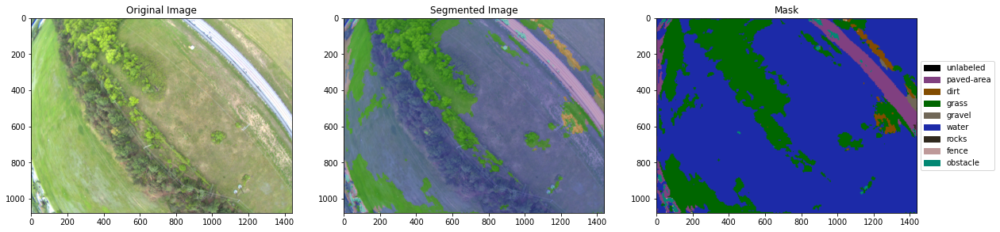

...

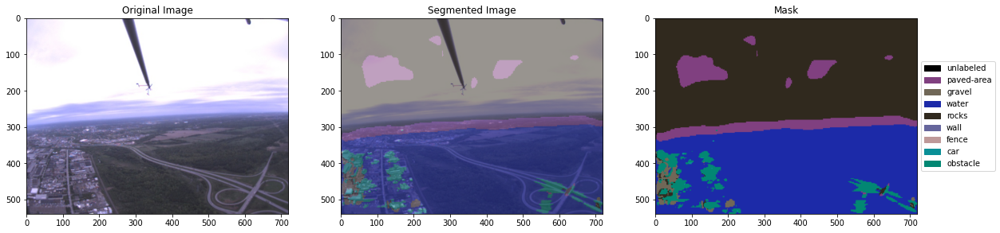

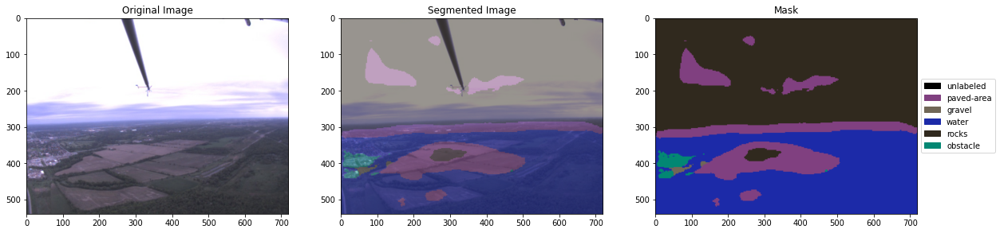

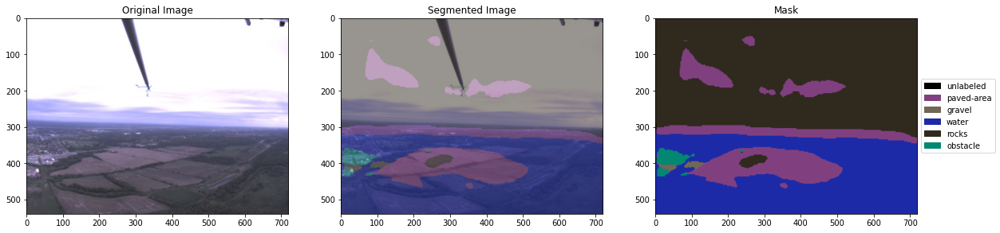

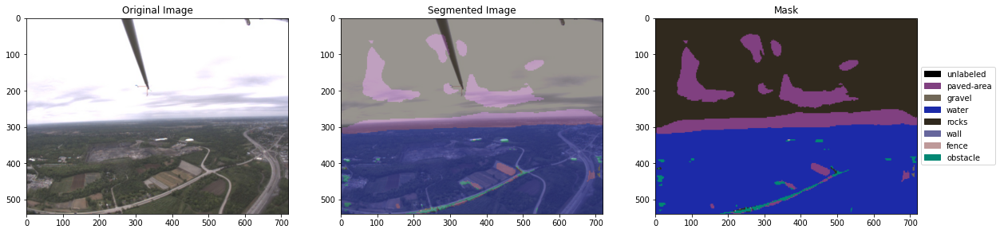

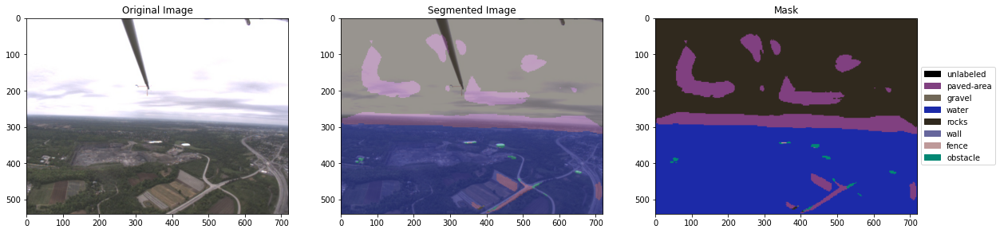

In [ ]:
# New weights
import glob
from tqdm import tqdm
from keras_segmentation.data_utils.data_loader import get_image_array

output_width = model.output_width
output_height = model.output_height
input_width = model.input_width
input_height = model.input_height
n_classes = model.n_classes
inps = glob.glob(os.path.join(TEST_IMAGES, "*.jpg")) + \
    glob.glob(os.path.join(TEST_IMAGES, "*.JPG"))
inps = sorted(inps)
for inp in tqdm(inps):
  inp = cv.imread(inp, 1)
  x = get_image_array(inp, input_width, input_height,ordering=None)
  pr = model.predict(np.array([x]))[0]
  pr = pr.reshape((output_height,  output_width, n_classes)).argmax(axis=2)
  pr = cv.resize(pr, (inp.shape[1], inp.shape[0]), interpolation=cv.INTER_NEAREST)
  h=create_legend_handles(pr,color_map)
  pr = mask_to_color(pr,color_map)
  inp = cv.cvtColor(inp,cv.COLOR_BGR2RGB)
  fig ,arr  = plt.subplots(1,3,figsize=(20,15))
  arr[0].imshow(inp)
  arr[0].set_title('Original Image')
  arr[1].imshow(inp)
  arr[1].imshow(pr,alpha=0.5)
  arr[1].set_title('Segmented Image')
  arr[2].imshow(pr)
  arr[2].set_title('Mask')
  arr[2].legend(handles=h,bbox_to_anchor=(1, 0.5), loc='center left')

  0%|          | 0/36 [00:00<?, ?it/s]

100%|██████████| 36/36 [00:24<00:00,  1.49it/s]


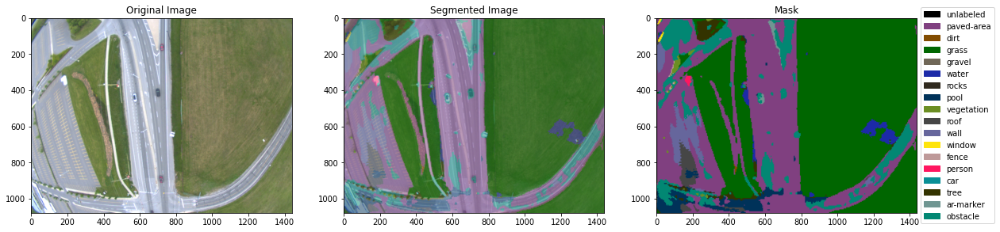

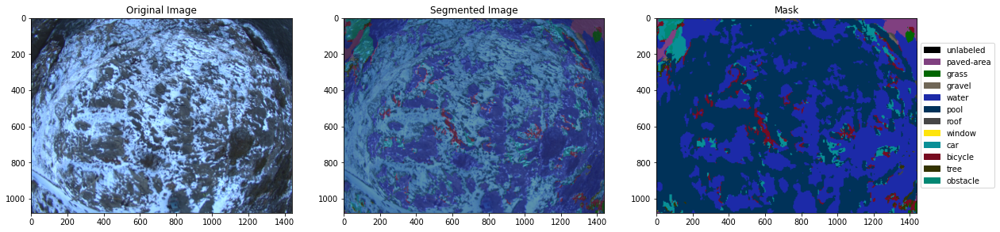

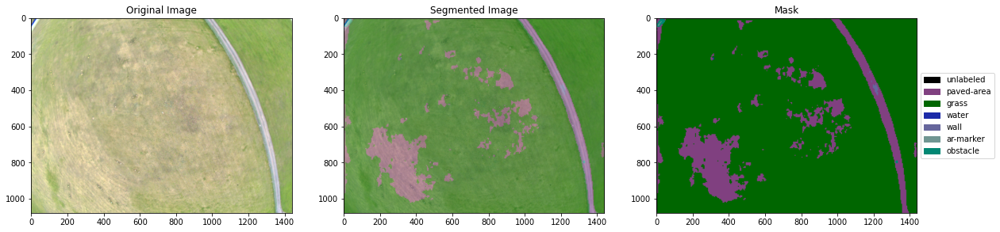

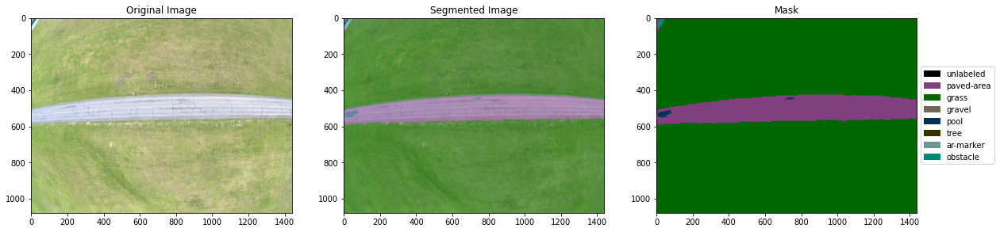

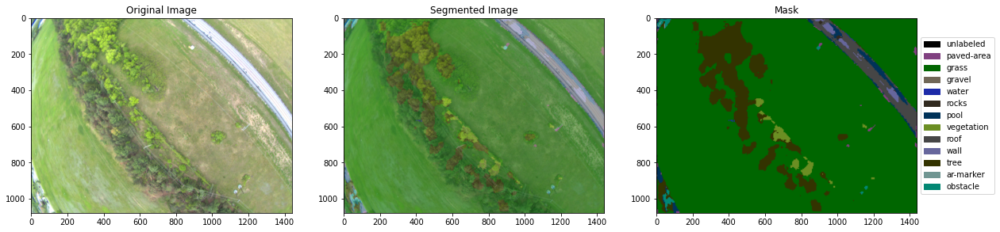

...

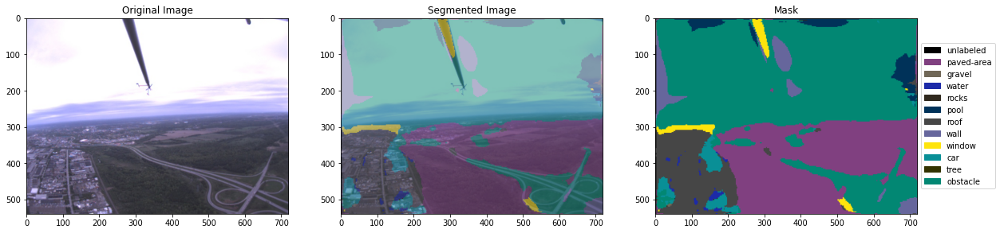

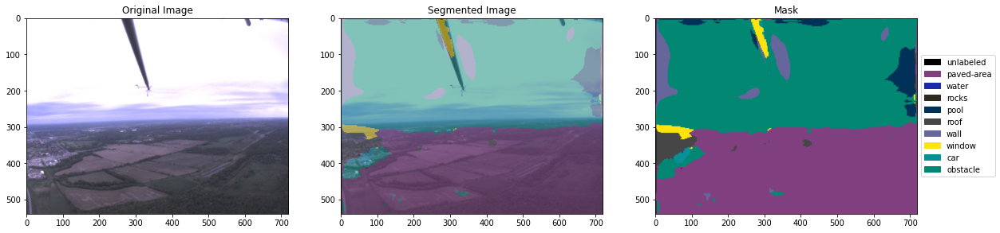

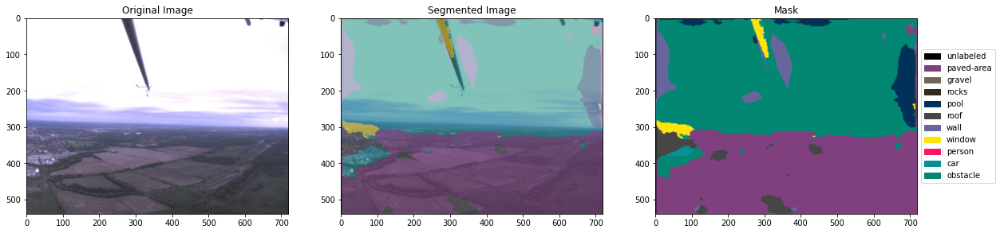

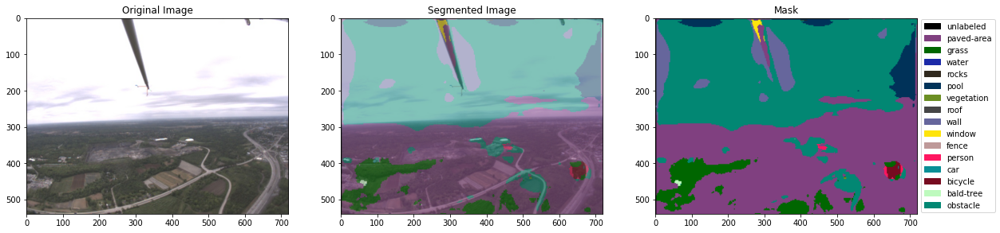

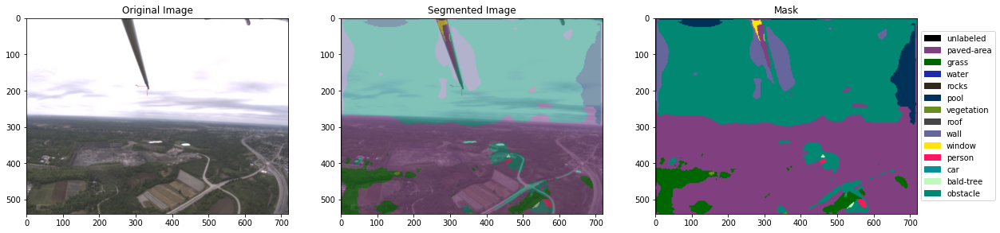

In [ ]:
# Old weights
import glob
from tqdm import tqdm
from keras_segmentation.data_utils.data_loader import get_image_array

output_width = model.output_width
output_height = model.output_height
input_width = model.input_width
input_height = model.input_height
n_classes = model.n_classes
inps = glob.glob(os.path.join(TEST_IMAGES, "*.jpg")) + \
    glob.glob(os.path.join(TEST_IMAGES, "*.JPG"))
inps = sorted(inps)
for inp in tqdm(inps):
  inp = cv.imread(inp, 1)
  x = get_image_array(inp, input_width, input_height,ordering=None)
  pr = model.predict(np.array([x]))[0]
  pr = pr.reshape((output_height,  output_width, n_classes)).argmax(axis=2)
  pr = cv.resize(pr, (inp.shape[1], inp.shape[0]), interpolation=cv.INTER_NEAREST)
  h=create_legend_handles(pr,color_map)
  pr = mask_to_color(pr,color_map)
  inp = cv.cvtColor(inp,cv.COLOR_BGR2RGB)
  fig ,arr  = plt.subplots(1,3,figsize=(20,15))
  arr[0].imshow(inp)
  arr[0].set_title('Original Image')
  arr[1].imshow(inp)
  arr[1].imshow(pr,alpha=0.5)
  arr[1].set_title('Segmented Image')
  arr[2].imshow(pr)
  arr[2].set_title('Mask')
  arr[2].legend(handles=h,bbox_to_anchor=(1, 0.5), loc='center left')